<a href="https://colab.research.google.com/github/VerbVal/ML_course_yandex/blob/main/CLIP_%26_Segmentation_Task.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Interacting with CLIP

This is a self-contained notebook that shows how to download and run CLIP models, calculate the similarity between arbitrary image and text inputs, and perform zero-shot image classifications.

[Learning Transferable Visual Models From Natural Language Supervision](https://huggingface.co/papers/2103.00020): CLIP (Contrastive Language–Image Pretraining), introduced by Radford et al. in 2021, learns rich visual representations by training on roughly 400 million uncurated image–text pairs from the internet using a contrastive objective: an image encoder (e.g., ResNet or Vision Transformer) and a text encoder (a Transformer) each project inputs into a shared 512-dimensional space where matching image–caption pairs are pulled together and nonmatching pairs are pushed apart via an InfoNCE loss with a learned temperature. Without any task-specific fine-tuning, CLIP performs zero-shot classification by comparing cosine similarities between image embeddings and text embeddings of candidate labels (e.g., “a photo of a cat”), achieving ~76% zero-shot accuracy on ImageNet, strong robustness under distribution shift, and versatile transfer to retrieval, segmentation, and beyond, demonstrating that large-scale natural language supervision yields powerful, open-vocabulary vision models.

# Preparation for Colab

Make sure you're running a GPU runtime; if not, select "GPU" as the hardware accelerator in Runtime > Change Runtime Type in the menu. The next cells will install the `clip` package and its dependencies, and check if PyTorch 1.7.1 or later is installed.

In [ ]:
! pip install ftfy regex tqdm
! pip install git+https://github.com/openai/CLIP.git

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 5.1 MB/s eta 0:00:00
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-nvdlf2ut
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-nvdlf2ut
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369490 sha256=132214b24ad33192c4f87996cf0e2197875ce4c928a645d340005eedf4aeed70
  Stored in directory: /tmp/pip-ephem-wheel-cache-v77v86ng/wheels/35/3e/df/3d24cbfb3b6a06f17a2bfd7d1138900d4365d9028aa8f6e92f
Successfully built clip


In [ ]:
import numpy as np
import torch
from pkg_resources import packaging

print("Torch version:", torch.__version__)


Torch version: 2.8.0+cu126


/tmp/ipython-input-189856270.py:3: DeprecationWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html
  from pkg_resources import packaging


# Loading the model

`clip.available_models()` will list the names of available CLIP models.

In [ ]:
import clip

clip.available_models()

['RN50',
 'RN101',
 'RN50x4',
 'RN50x16',
 'RN50x64',
 'ViT-B/32',
 'ViT-B/16',
 'ViT-L/14',
 'ViT-L/14@336px']

In [ ]:
model, preprocess = clip.load("ViT-B/32")
model.cuda().eval()
input_resolution = model.visual.input_resolution
context_length = model.context_length
vocab_size = model.vocab_size

print("Model parameters:", f"{np.sum([int(np.prod(p.shape)) for p in model.parameters()]):,}")
print("Input resolution:", input_resolution)
print("Context length:", context_length)
print("Vocab size:", vocab_size)

100%|███████████████████████████████████████| 338M/338M [00:11<00:00, 30.9MiB/s]


Model parameters: 151,277,313
Input resolution: 224
Context length: 77
Vocab size: 49408


# Image Preprocessing

We resize the input images and center-crop them to conform with the image resolution that the model expects. Before doing so, we will normalize the pixel intensity using the dataset mean and standard deviation.

The second return value from `clip.load()` contains a torchvision `Transform` that performs this preprocessing.



In [ ]:
preprocess

Compose(
    Resize(size=224, interpolation=bicubic, max_size=None, antialias=True)
    CenterCrop(size=(224, 224))
    <function _convert_image_to_rgb at 0x79da77f81580>
    ToTensor()
    Normalize(mean=(0.48145466, 0.4578275, 0.40821073), std=(0.26862954, 0.26130258, 0.27577711))
)

# Text Preprocessing

We use a case-insensitive tokenizer, which can be invoked using `clip.tokenize()`. By default, the outputs are padded to become 77 tokens long, which is what the CLIP models expects.

In [ ]:
clip.tokenize("Hello World!")

tensor([[49406,  3306,  1002,   256, 49407,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0]], dtype=torch.int32)

# Setting up input images and texts

We are going to feed 8 example images and their textual descriptions to the model, and compare the similarity between the corresponding features.

The tokenizer is case-insensitive, and we can freely give any suitable textual descriptions.

In [ ]:
# !pip install scikit-image

In [ ]:
import os
import skimage
import IPython.display
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

from collections import OrderedDict
import torch

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# images in skimage to use and their textual descriptions
descriptions = {
    "page": "a page of text about segmentation",
    "chelsea": "a facial photo of a tabby cat",
    "astronaut": "a portrait of an astronaut with the American flag",
    "rocket": "a rocket standing on a launchpad",
    "motorcycle_right": "a red motorcycle standing in a garage",
    "camera": "a person looking at a camera on a tripod",
    "horse": "a black-and-white silhouette of a horse",
    "coffee": "a cup of coffee on a saucer"
}

In [ ]:
# !ls /content/.cache/scikit-image/

In [ ]:
# !ls skimage.data_dir

In [ ]:
skimage.data.download_all()

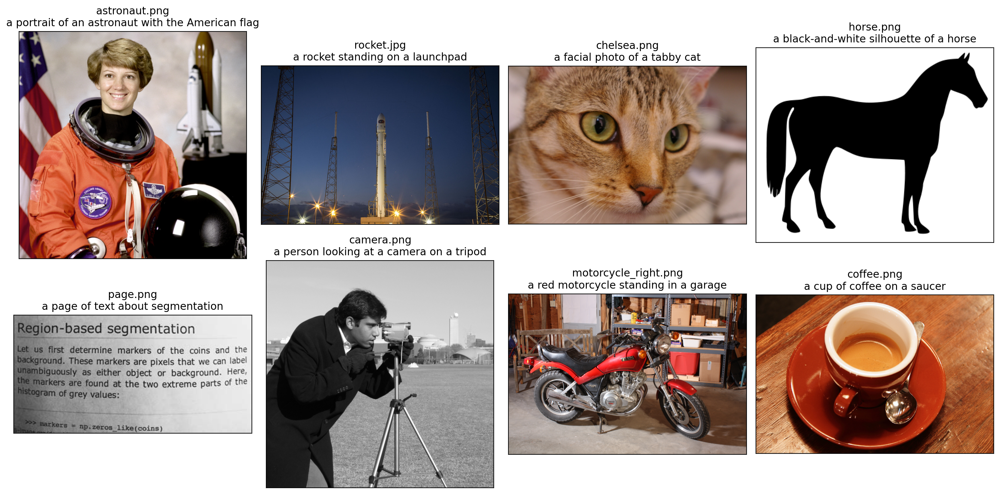

In [ ]:
original_images = []
images = []
texts = []
plt.figure(figsize=(16, 8))

for filename in [filename for filename in os.listdir(skimage.data_dir) if filename.endswith(".png") or filename.endswith(".jpg")]:
    name = os.path.splitext(filename)[0]
    if name not in descriptions:
        continue

    image = Image.open(os.path.join(skimage.data_dir, filename)).convert("RGB")

    plt.subplot(2, 4, len(images) + 1)
    plt.imshow(image)
    plt.title(f"{filename}\n{descriptions[name]}")
    plt.xticks([])
    plt.yticks([])

    original_images.append(image)
    images.append(preprocess(image))
    texts.append(descriptions[name])

plt.tight_layout()


## Building features

We normalize the images, tokenize each text input, and run the forward pass of the model to get the image and text features.

In [ ]:
image_input = torch.tensor(np.stack(images)).cuda()
text_tokens = clip.tokenize(["This is " + desc for desc in texts]).cuda()

In [ ]:
with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    text_features = model.encode_text(text_tokens).float()

## Calculating cosine similarity

We normalize the features and calculate the dot product of each pair.

In [ ]:
image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T

In [ ]:
similarity

array([[0.27675667, 0.22062966, 0.1680886 , 0.1627326 , 0.12999386,
        0.16577631, 0.1501373 , 0.14954525],
       [0.19189125, 0.30291915, 0.17755245, 0.16988513, 0.17417258,
        0.2015791 , 0.1581296 , 0.13831046],
       [0.11956881, 0.11880036, 0.30740866, 0.15262885, 0.12092064,
        0.15962751, 0.12495109, 0.16607083],
       [0.11465158, 0.14865252, 0.14572413, 0.3460254 , 0.17258137,
        0.21314378, 0.16732281, 0.15419684],
       [0.14669068, 0.15956005, 0.20109828, 0.20003419, 0.35393515,
        0.20150778, 0.1630938 , 0.19827604],
       [0.18587793, 0.20690237, 0.20820786, 0.19507915, 0.18862328,
        0.30475357, 0.16067713, 0.13665539],
       [0.15481889, 0.15926251, 0.15409966, 0.1622283 , 0.14269832,
        0.11977127, 0.32051712, 0.12517986],
       [0.14813997, 0.1226058 , 0.18380328, 0.15405694, 0.14372635,
        0.17415103, 0.12159766, 0.29309893]], dtype=float32)

Text(0.5, 1.0, 'Cosine similarity between text and image features')

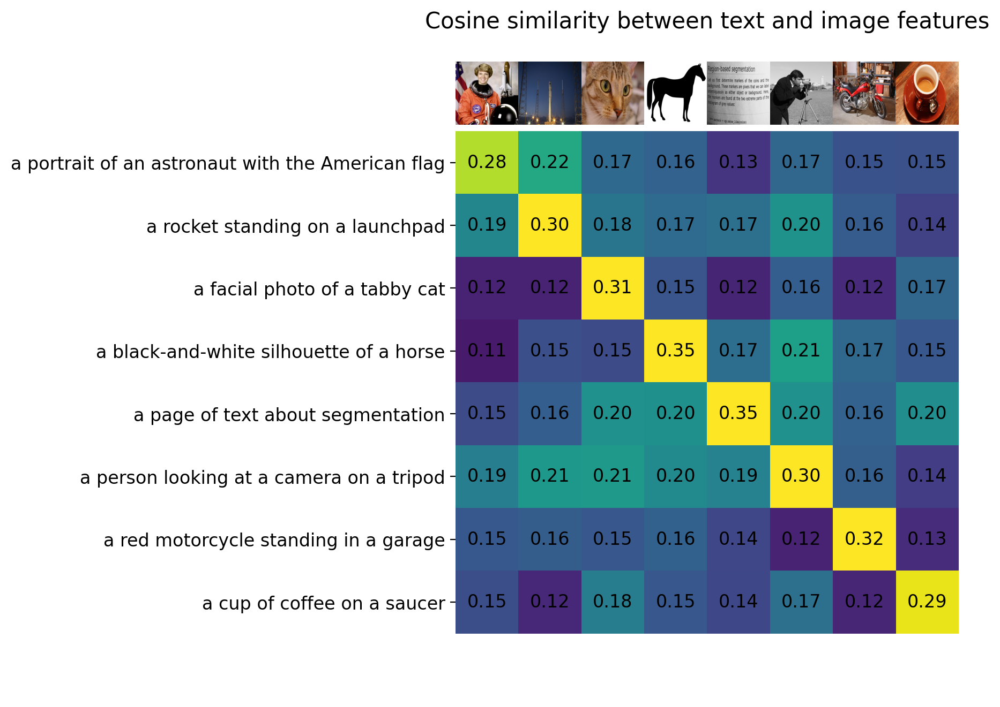

In [ ]:
count = len(descriptions)

plt.figure(figsize=(11, 8))
plt.imshow(similarity, vmin=0.1, vmax=0.3)
# plt.colorbar()
plt.yticks(range(count), texts, fontsize=12)
plt.xticks([])
for i, image in enumerate(original_images):
    plt.imshow(image, extent=(i - 0.5, i + 0.5, -1.6, -0.6), origin="lower")
for x in range(similarity.shape[1]):
    for y in range(similarity.shape[0]):
        plt.text(x, y, f"{similarity[y, x]:.2f}", ha="center", va="center", size=12)

for side in ["left", "top", "right", "bottom"]:
  plt.gca().spines[side].set_visible(False)

plt.xlim([-0.5, count - 0.5])
plt.ylim([count + 0.5, -2])

plt.title("Cosine similarity between text and image features", size=15)

# Zero-Shot Image Classification

You can classify images using the cosine similarity (times 100) as the logits to the softmax operation.

In [ ]:
from torchvision.datasets import CIFAR100

cifar100 = CIFAR100(os.path.expanduser("~/.cache"), transform=preprocess, download=True)

100%|██████████| 169M/169M [00:19<00:00, 8.64MB/s]


In [ ]:
classes = [f"{label}" for label in cifar100.classes]
classes.append('cat')
classes.append('book')
classes.append('text')
classes.append('horse')
text_tokens = clip.tokenize(classes).cuda()

In [ ]:
# text_descriptions

In [ ]:
text_tokens[1]

tensor([49406, 16814,   318,  2759, 49407,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
            0,     0,     0,     0,     0,     0,     0], device='cuda:0',
       dtype=torch.int32)

In [ ]:
text_descriptions = [f"This is a photo of a {label}" for label in cifar100.classes]
text_descriptions.append("This is a photo of a cat")
text_descriptions.append("This is a photo of a book")
text_descriptions.append( "This is a photo of a text")
text_descriptions.append( "This is a photo of a horse")
text_tokens = clip.tokenize(text_descriptions).cuda()

In [ ]:
# text_descriptions

In [ ]:
with torch.no_grad():
    text_features = model.encode_text(text_tokens).float()
    text_features /= text_features.norm(dim=-1, keepdim=True)

text_probs = (100.0 * image_features @ text_features.T).softmax(dim=-1)
top_probs, top_labels = text_probs.cpu().topk(5, dim=-1)

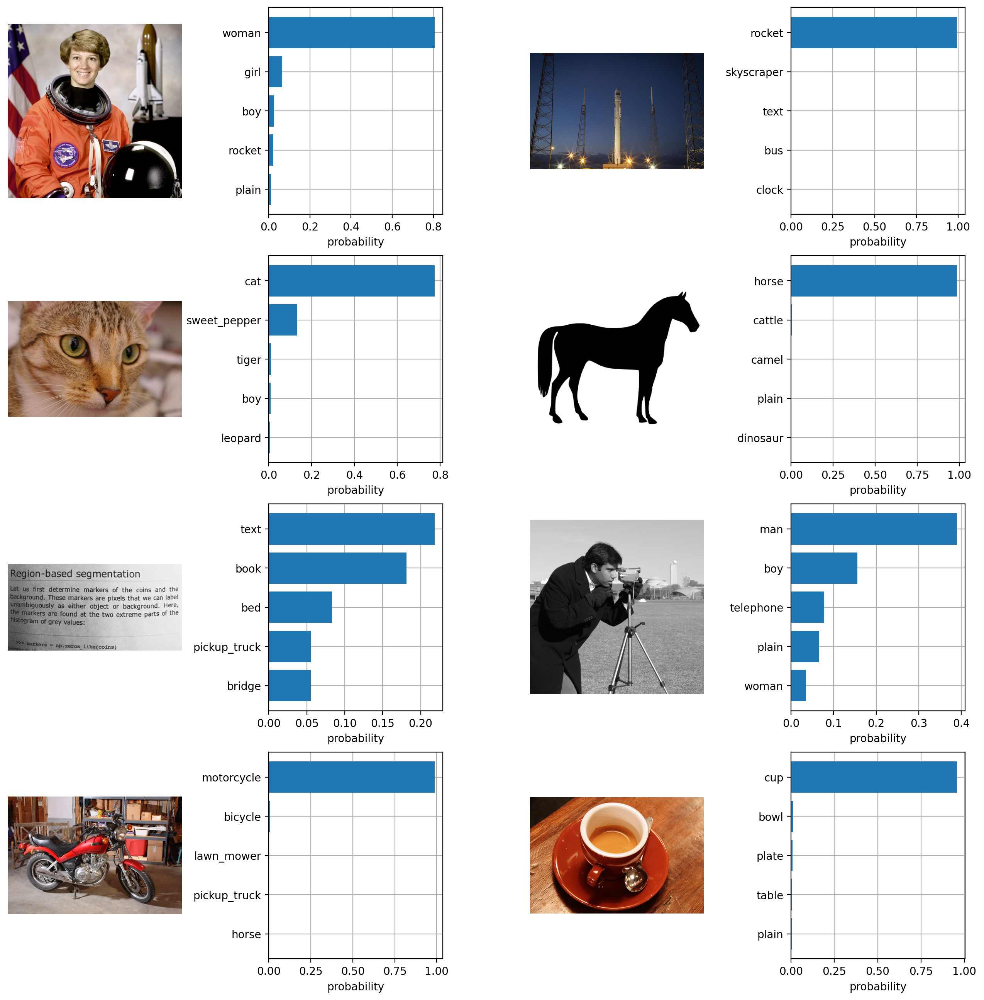

In [ ]:
plt.figure(figsize=(16, 16))

for i, image in enumerate(original_images):
    plt.subplot(4, 4, 2 * i + 1)
    plt.imshow(image)
    plt.axis("off")

    plt.subplot(4, 4, 2 * i + 2)
    y = np.arange(top_probs.shape[-1])
    plt.grid()
    plt.barh(y, top_probs[i])
    plt.gca().invert_yaxis()
    plt.gca().set_axisbelow(True)
    # plt.yticks(y, [cifar100.classes[index] for index in top_labels[i].numpy()])
    plt.yticks(y, [classes[index] for index in top_labels[i].numpy()])
    plt.xlabel("probability")

plt.subplots_adjust(wspace=0.5)
plt.show()

# Image Segmentation

We will implement a lightweight image segmentation model using the U-Net architecture, which is well-suited for segmentation tasks and can run efficiently in a Jupyter notebook environment. We'll use the same images that were previously processed with CLIP, but now we'll perform semantic segmentation on them.

Paper: [U-Net: Convolutional Networks for Biomedical Image Segmentation](https://arxiv.org/abs/1505.04597)

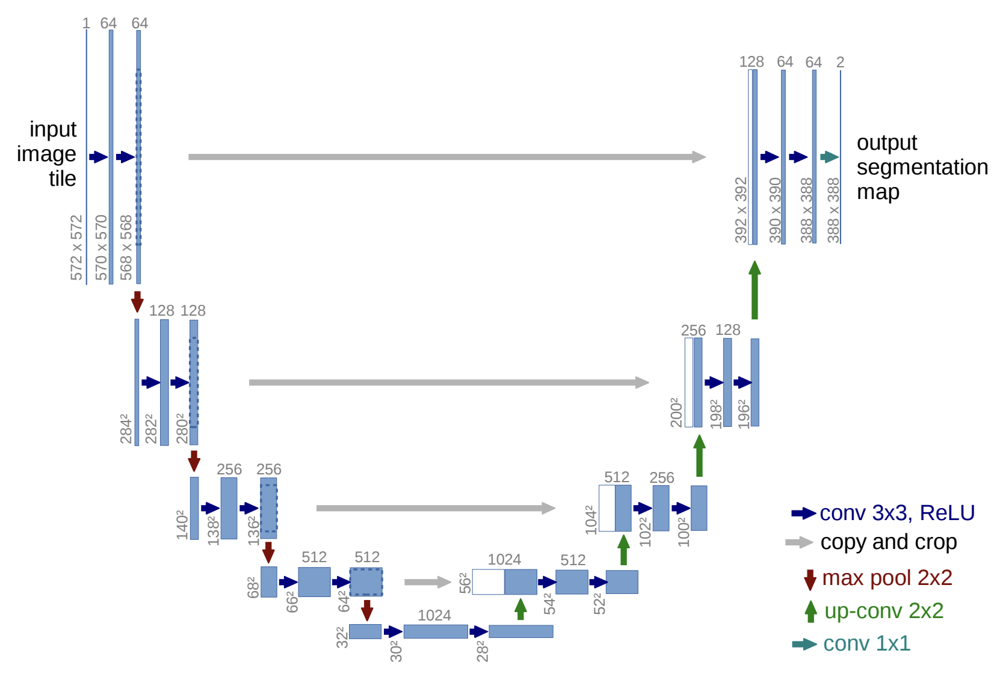

In [ ]:
!pip install torch torchvision segmentation-models-pytorch albumentations

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.8/154.8 kB 14.3 MB/s eta 0:00:00


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as transforms
from torchvision.models.segmentation import fcn_resnet50
import skimage.data
from skimage.data import download_all

[PASCAL Visual Object Classes (VOC)](https://paperswithcode.com/dataset/pascal-voc) 2012 dataset contains 20 object categories including vehicles, household, animals, and other classes.

Instead of training our own model from scratch, we'll use a pre-trained segmentation model from torchvision. This will save time and provide good results out of the box.

More info about [fcn_resnet50 pre-trained model](https://pytorch.org/vision/main/models/generated/torchvision.models.segmentation.fcn_resnet50.html).

In [ ]:
# Load pre-trained FCN model with ResNet-50 backbone
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = fcn_resnet50(pretrained=True).to(device)
model.eval()

# Define the class labels for PASCAL VOC dataset
CLASSES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tvmonitor'
]

# Define a colormap for visualization
COLORMAP = np.random.randint(0, 256, (len(CLASSES), 3), dtype=np.uint8)
# Background is black
COLORMAP[0] = [0, 0, 0]

/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FCN_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=FCN_ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/fcn_resnet50_coco-1167a1af.pth" to /root/.cache/torch/hub/checkpoints/fcn_resnet50_coco-1167a1af.pth


100%|██████████| 135M/135M [00:00<00:00, 170MB/s]


We need to preprocess our images to match the input requirements of the segmentation model.

In [ ]:
def preprocess_image(image):
    image = image.resize((512, 512))

    preprocess = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])

    input_tensor = preprocess(image)
    # Add batch dimension
    input_batch = input_tensor.unsqueeze(0)

    return input_batch.to(device)

Now, let's create a function to perform segmentation and visualize the results.

In [ ]:
def segment_and_visualize(image, original_filename, description):
    input_batch = preprocess_image(image)

    # segmentation
    with torch.no_grad():
        output = model(input_batch)['out'][0]

    # predicted class for each pixel
    output_predictions = output.argmax(0).cpu().numpy()

    # colored segmentation map
    segmentation_map = COLORMAP[output_predictions]

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 5))

    ax1.imshow(image)
    ax1.set_title(f"Original: {original_filename}\n{description}")
    ax1.axis('off')

    ax2.imshow(segmentation_map)
    ax2.set_title("Segmentation Map")
    ax2.axis('off')

    unique_classes = np.unique(output_predictions)
    legend_elements = [plt.Rectangle((0, 0), 1, 1, color=COLORMAP[i]/255.0,
                                    label=CLASSES[i]) for i in unique_classes]
    fig.legend(handles=legend_elements, loc='lower center', ncol=len(unique_classes))

    plt.tight_layout()
    plt.subplots_adjust(bottom=0.15)

    return output_predictions, unique_classes

Let's process the same images we used with CLIP, but now with our segmentation model.


Segmentation Results Summary:
Image: astronaut.png (an astronaut)
Classes detected: background, bottle, person
--------------------------------------------------
Image: rocket.jpg (a rocket)
Classes detected: background, boat
--------------------------------------------------
Image: chelsea.png (a cat)
Classes detected: background, cat, dog
--------------------------------------------------
Image: horse.png (a horse)
Classes detected: background, horse, person
--------------------------------------------------
Image: camera.png (a camera)
Classes detected: background, person
--------------------------------------------------
Image: motorcycle_right.png (a motorcycle)
Classes detected: background, motorbike
--------------------------------------------------
Image: coffee.png (a cup of coffee)
Classes detected: background, diningtable
--------------------------------------------------


<Figure size 1200x1200 with 0 Axes>

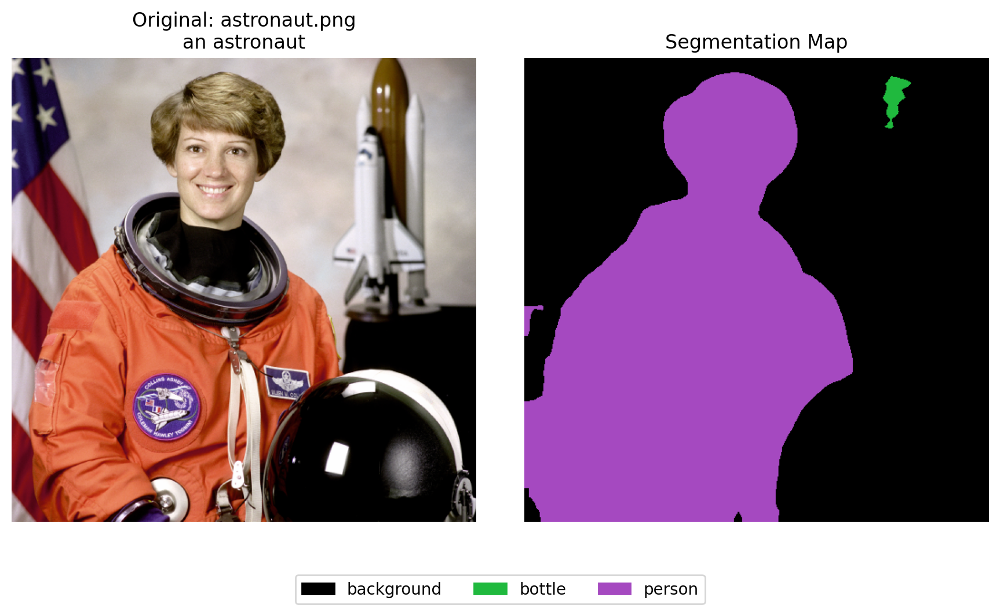

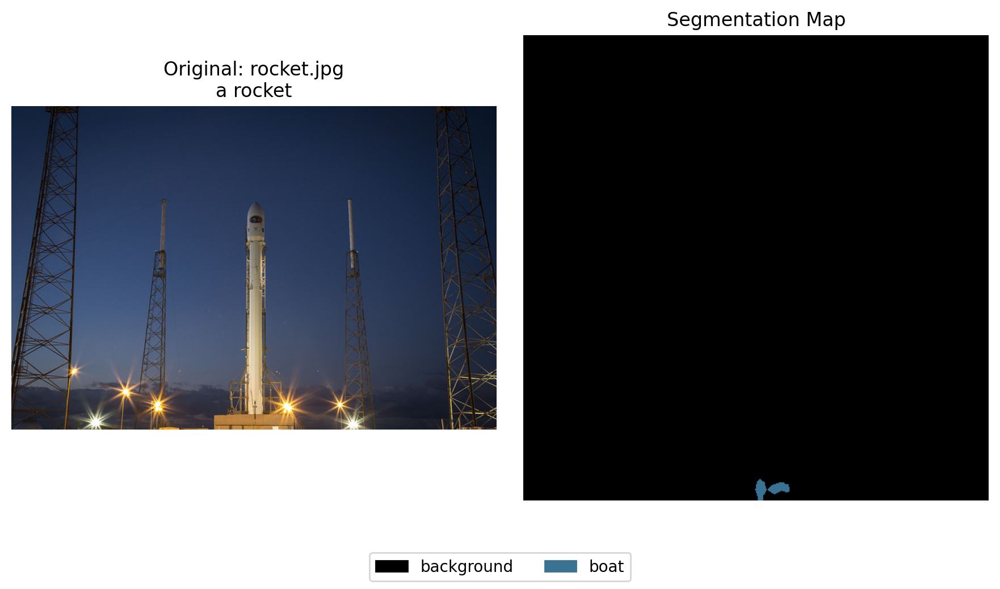

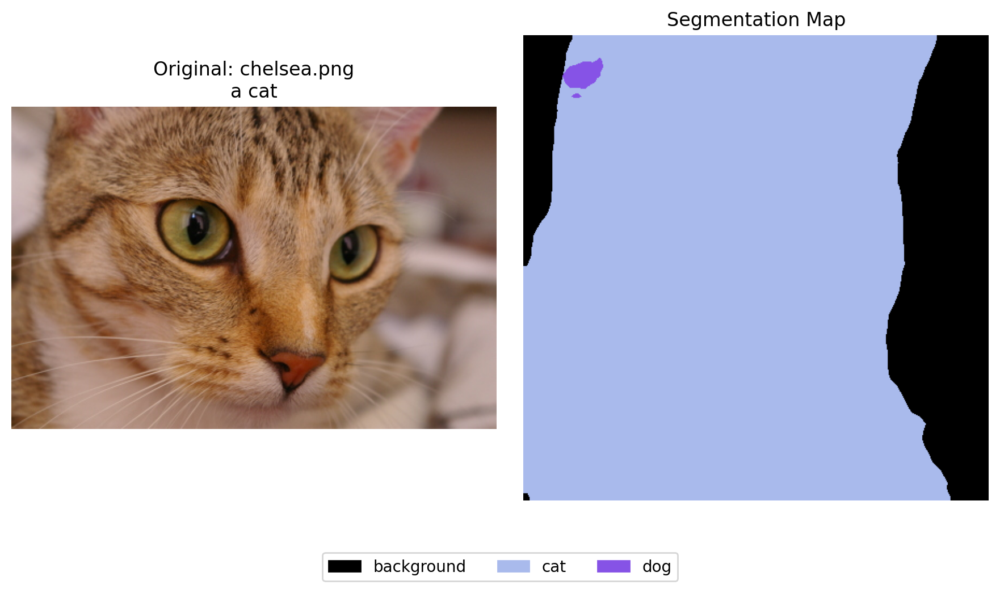

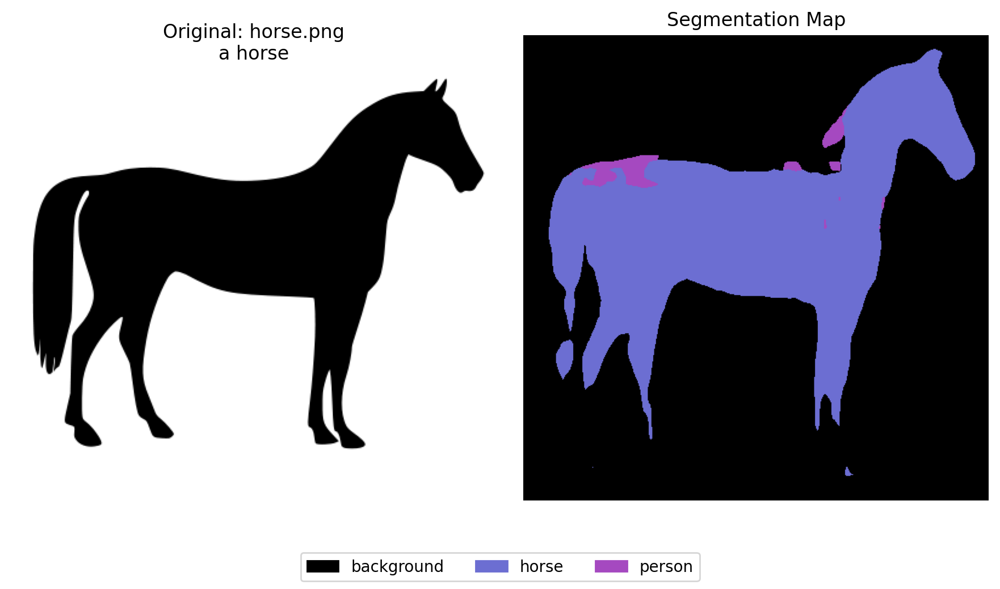

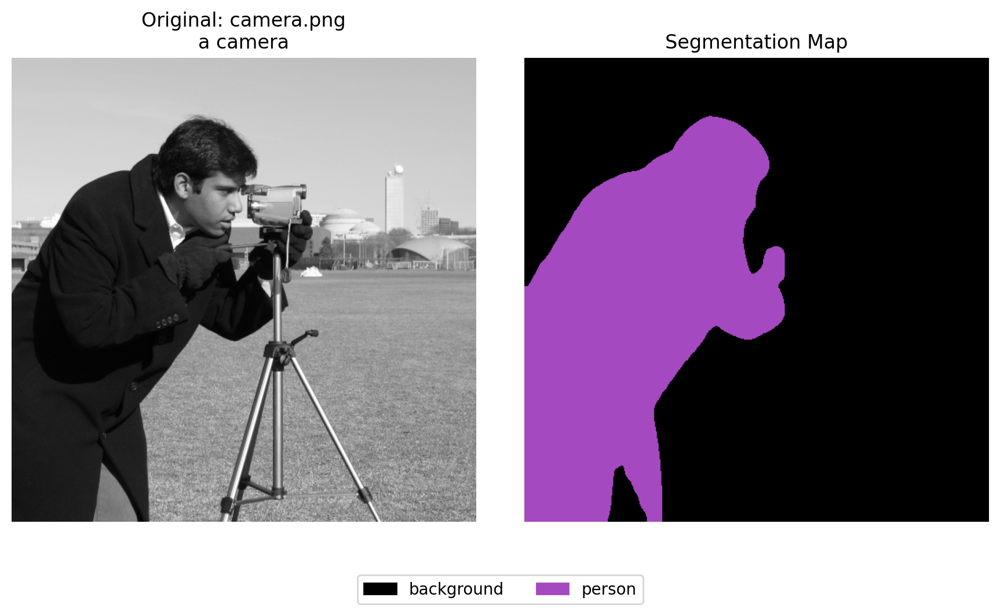

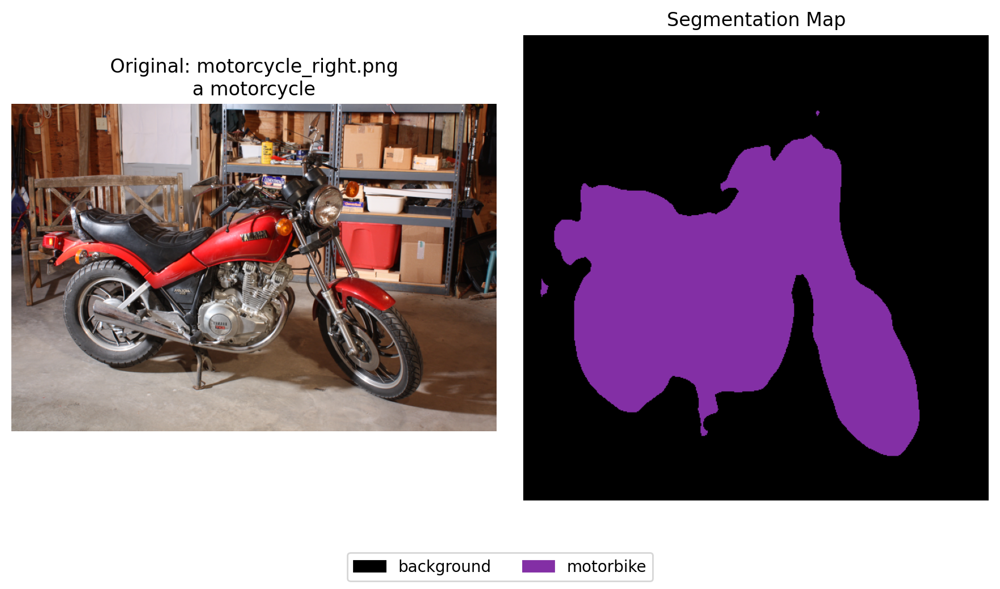

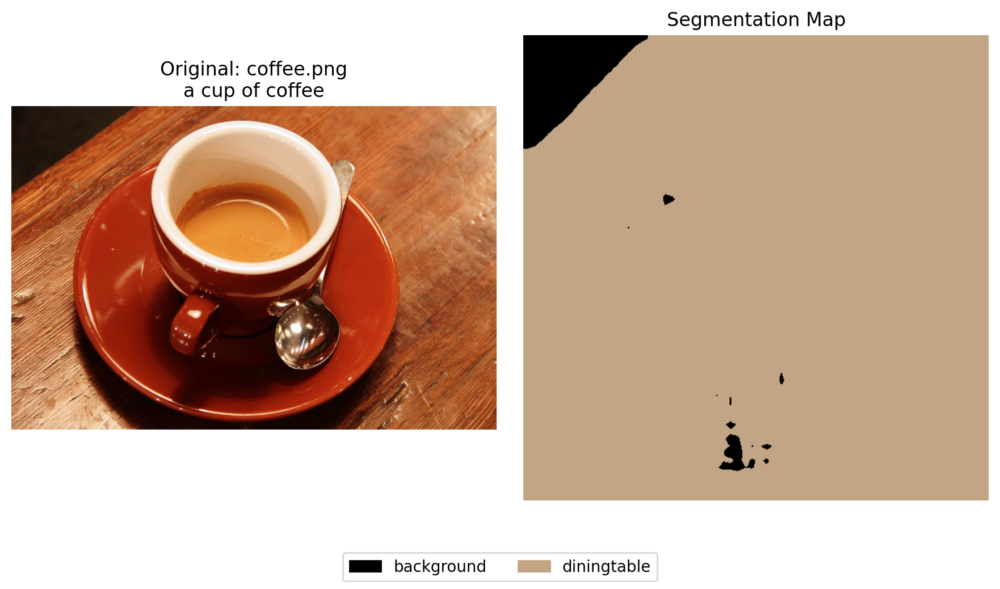

In [ ]:
# image descriptions
descriptions = {
    "astronaut": "an astronaut",
    "camera": "a camera",
    "coffee": "a cup of coffee",
    "horse": "a horse",
    "motorcycle_right": "a motorcycle",
    "rocket": "a rocket",
    "chelsea": "a cat",
    "clock": "a clock"
}

download_all()

plt.figure(figsize=(12, 12))
segmentation_results = []

for i, filename in enumerate([f for f in os.listdir(skimage.data_dir)
                             if f.endswith(".png") or f.endswith(".jpg")]):
    name = os.path.splitext(filename)[0]
    if name not in descriptions:
        continue

    image_path = os.path.join(skimage.data_dir, filename)
    image = Image.open(image_path).convert("RGB")

    # segmentation and visualization
    predictions, classes = segment_and_visualize(image, filename, descriptions[name])

    segmentation_results.append({
        'filename': filename,
        'description': descriptions[name],
        'classes_found': [CLASSES[i] for i in classes]
    })

    plt.plot()

print("\nSegmentation Results Summary:")
for result in segmentation_results:
    print(f"Image: {result['filename']} ({result['description']})")
    print(f"Classes detected: {', '.join(result['classes_found'])}")
    print("-" * 50)

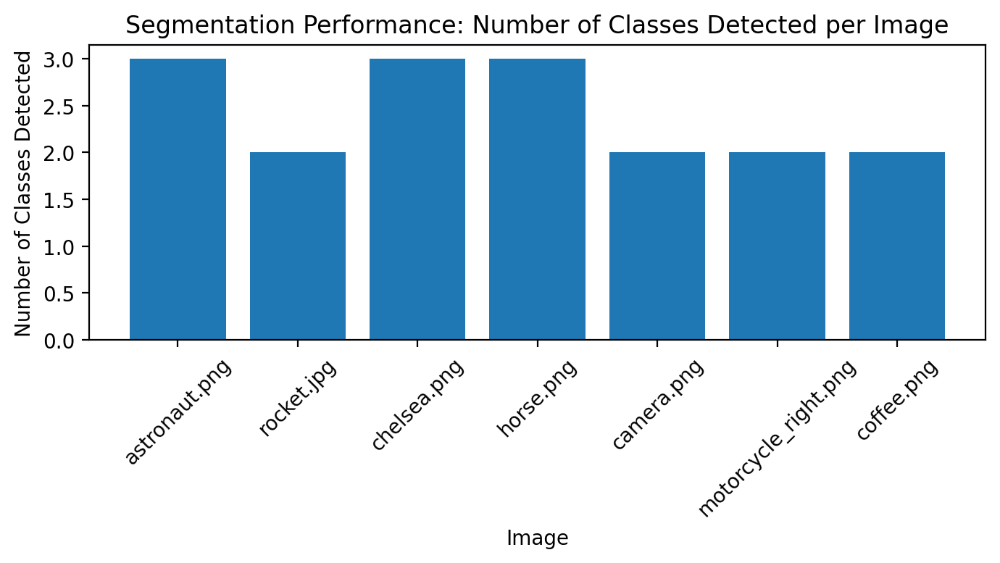

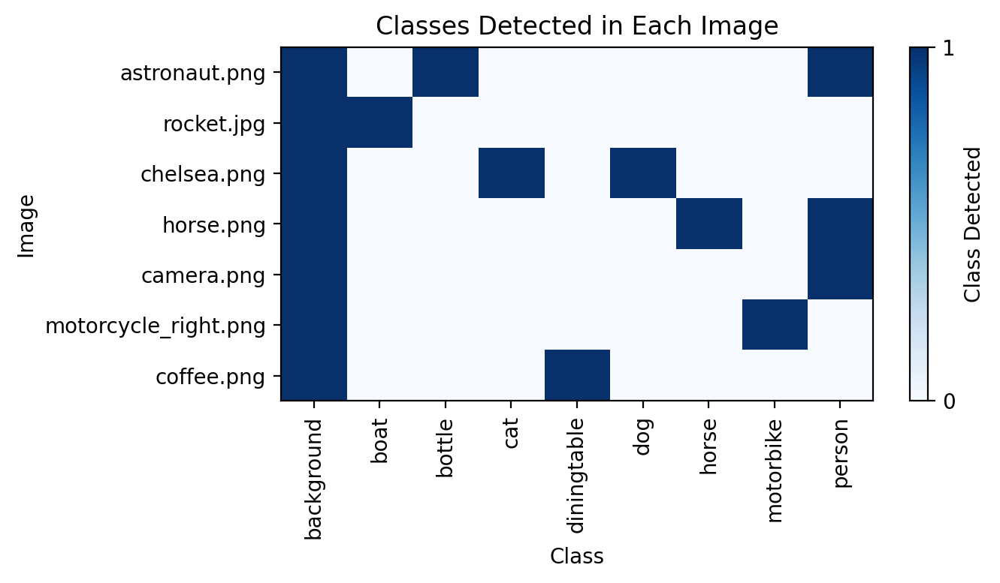

In [ ]:
# bar chart showing the number of classes detected in each image
plt.figure(figsize=(7, 4))
image_names = [result['filename'] for result in segmentation_results]
class_counts = [len(result['classes_found']) for result in segmentation_results]

plt.bar(image_names, class_counts)
plt.xlabel('Image')
plt.ylabel('Number of Classes Detected')
plt.title('Segmentation Performance: Number of Classes Detected per Image')
plt.xticks(rotation=45)
plt.tight_layout()

# heatmap showing which classes were detected in which images
detected_classes = set()
for result in segmentation_results:
    detected_classes.update(result['classes_found'])

detected_classes = sorted(list(detected_classes))
heatmap_data = np.zeros((len(segmentation_results), len(detected_classes)))

for i, result in enumerate(segmentation_results):
    for j, class_name in enumerate(detected_classes):
        if class_name in result['classes_found']:
            heatmap_data[i, j] = 1

plt.figure(figsize=(7, 4))
plt.imshow(heatmap_data, cmap='Blues', aspect='auto')
plt.colorbar(ticks=[0, 1], label='Class Detected')
plt.xticks(np.arange(len(detected_classes)), detected_classes, rotation=90)
plt.yticks(np.arange(len(segmentation_results)), image_names)
plt.xlabel('Class')
plt.ylabel('Image')
plt.title('Classes Detected in Each Image')
plt.tight_layout()

# Advanced Image Segmentation with a Heavier Model

In this section, we'll implement a more sophisticated segmentation model to achieve better results. We'll use **DeepLabV3+** with a ResNet-101 backbone, which is known for its excellent performance in semantic segmentation tasks. This model is heavier than the previous FCN-ResNet50 but provides more accurate segmentation results.

Paper: [Encoder-Decoder with Atrous Separable Convolution for Semantic Image Segmentation](https://arxiv.org/abs/1802.02611)

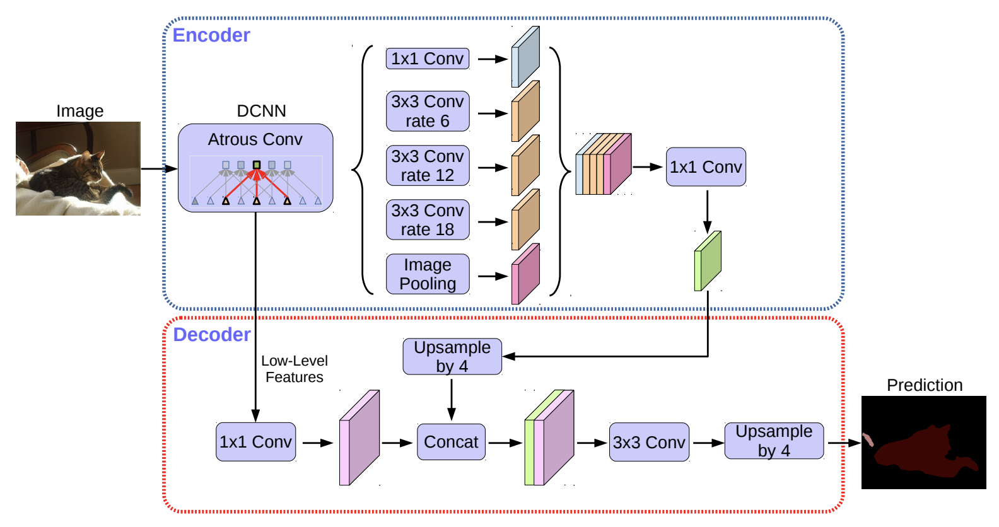

In [ ]:
from torchvision.models.segmentation import deeplabv3_resnet101

In [ ]:
# pre-trained DeepLabV3+ model with ResNet-101 backbone
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
deeplabv3_model = deeplabv3_resnet101(pretrained=True, progress=True).to(device)
deeplabv3_model.eval()

np.random.seed(42)
COLORMAP = np.random.randint(0, 256, (len(CLASSES), 3), dtype=np.uint8)
COLORMAP[0] = [0, 0, 0]

/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_ResNet101_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/deeplabv3_resnet101_coco-586e9e4e.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_resnet101_coco-586e9e4e.pth


100%|██████████| 233M/233M [00:01<00:00, 182MB/s]


We'll enhance our preprocessing function to handle different input sizes and apply more transformations.

In [ ]:
def advanced_preprocess_image(image, target_size=(512, 512)):
    # keep ratio while resizing
    width, height = image.size
    ratio = min(target_size[0] / width, target_size[1] / height)
    new_size = (int(width * ratio), int(height * ratio))

    resized_image = image.resize(new_size, Image.LANCZOS)

    # black canvas of target size
    new_image = Image.new("RGB", target_size, (0, 0, 0))

    # resized image in the center
    paste_position = ((target_size[0] - new_size[0]) // 2,
                       (target_size[1] - new_size[1]) // 2)
    new_image.paste(resized_image, paste_position)

    preprocess = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])

    input_tensor = preprocess(new_image)
    input_batch = input_tensor.unsqueeze(0)

    return input_batch.to(device), paste_position, new_size

In [ ]:
def advanced_segment_and_visualize(image, original_filename, description):
    original_image = image.copy()

    input_batch, paste_position, new_size = advanced_preprocess_image(image)

    with torch.no_grad():
        output = deeplabv3_model(input_batch)['out'][0]

    # predicted class for each pixel
    output_predictions = output.argmax(0).cpu().numpy()

    segmentation_map = COLORMAP[output_predictions]

    # blended image (original + segmentation overlay)
    alpha = 0.5

    segmentation_pil = Image.fromarray(segmentation_map)

    original_resized = original_image.resize((512, 512), Image.LANCZOS)

    blended_image = Image.blend(original_resized, segmentation_pil.convert('RGB'), alpha)

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 6))

    ax1.imshow(original_image)
    ax1.set_title(f"Original: {original_filename}\n{description}")
    ax1.axis('off')

    ax2.imshow(segmentation_map)
    ax2.set_title("DeepLabV3+ Segmentation Map")
    ax2.axis('off')

    ax3.imshow(blended_image)
    ax3.set_title("Blended Segmentation")
    ax3.axis('off')

    unique_classes = np.unique(output_predictions)
    legend_elements = [plt.Rectangle((0, 0), 1, 1, color=COLORMAP[i]/255.0,
                                    label=f"{CLASSES[i]}") for i in unique_classes]
    fig.legend(handles=legend_elements, loc='lower center', ncol=min(len(unique_classes), 5))

    plt.tight_layout()
    plt.subplots_adjust(bottom=0.15)

    class_distribution = {}
    for cls in unique_classes:
        pixel_count = np.sum(output_predictions == cls)
        percentage = (pixel_count / output_predictions.size) * 100
        class_distribution[CLASSES[cls]] = percentage

    return output_predictions, unique_classes, class_distribution

Let's process our images with the advanced DeepLabV3+ model and compare the results.


DeepLabV3+ Segmentation Results Summary:

Image: astronaut.png (an astronaut)
Classes detected: background, person
Class distribution (% of pixels):
  - background: 56.94%
  - person: 43.06%
--------------------------------------------------
Image: rocket.jpg (a rocket)
Classes detected: background
Class distribution (% of pixels):
  - background: 100.00%
--------------------------------------------------
Image: chelsea.png (a cat)
Classes detected: background, cat
Class distribution (% of pixels):
  - background: 49.70%
  - cat: 50.30%
--------------------------------------------------
Image: horse.png (a horse)
Classes detected: background, horse
Class distribution (% of pixels):
  - background: 71.49%
  - horse: 28.51%
--------------------------------------------------
Image: camera.png (a camera)
Classes detected: background, person
Class distribution (% of pixels):
  - background: 69.77%
  - person: 30.23%
--------------------------------------------------
Image: motorcycle_right

<Figure size 1200x1200 with 0 Axes>

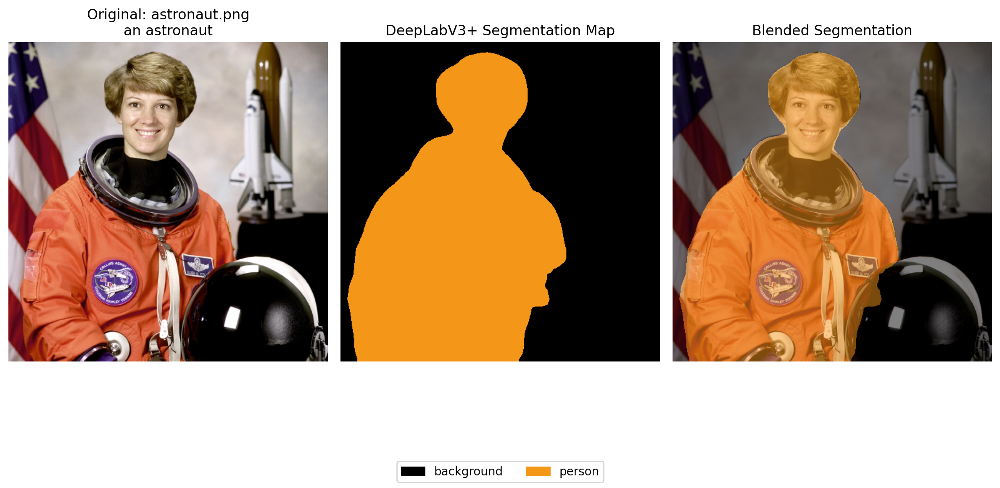

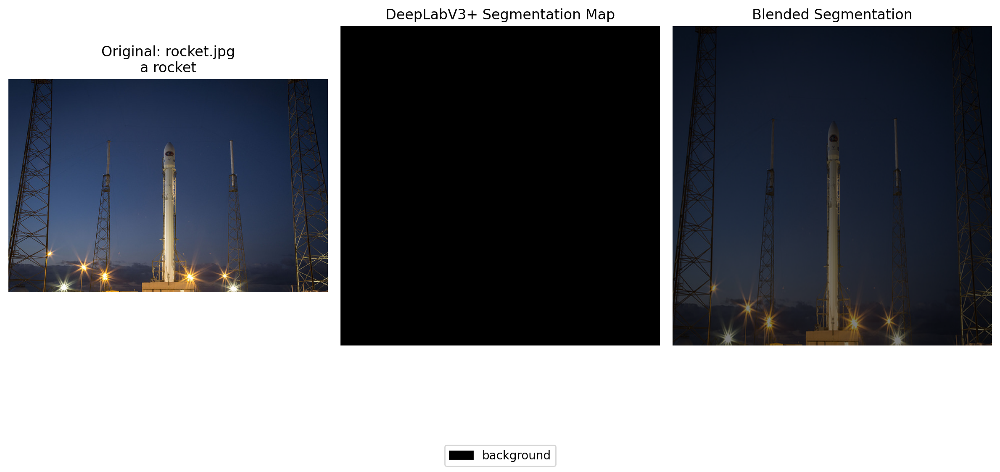

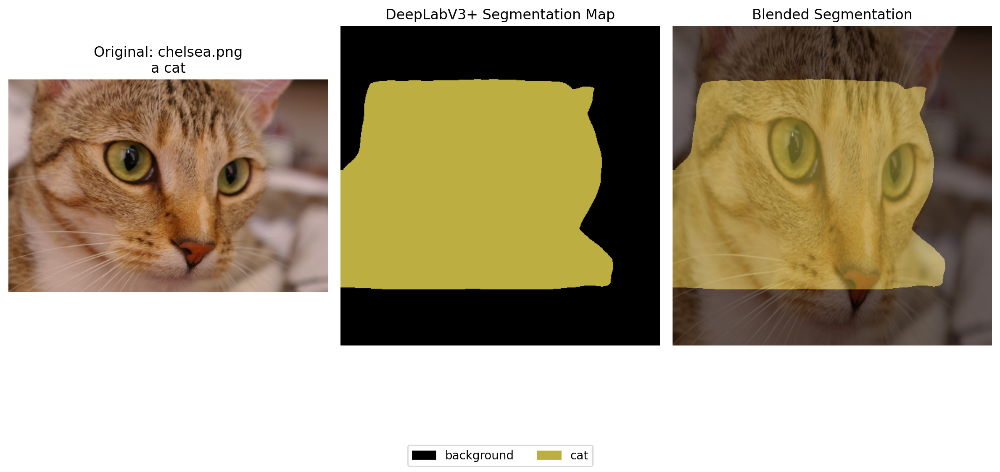

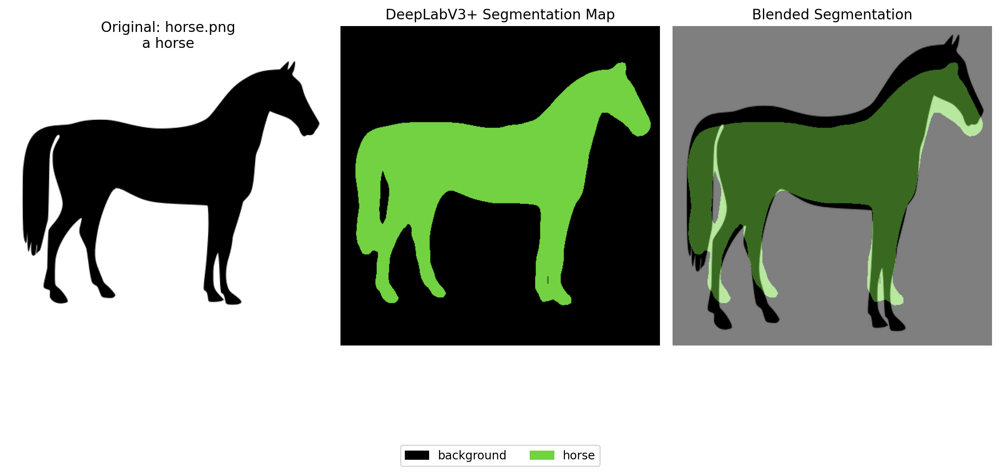

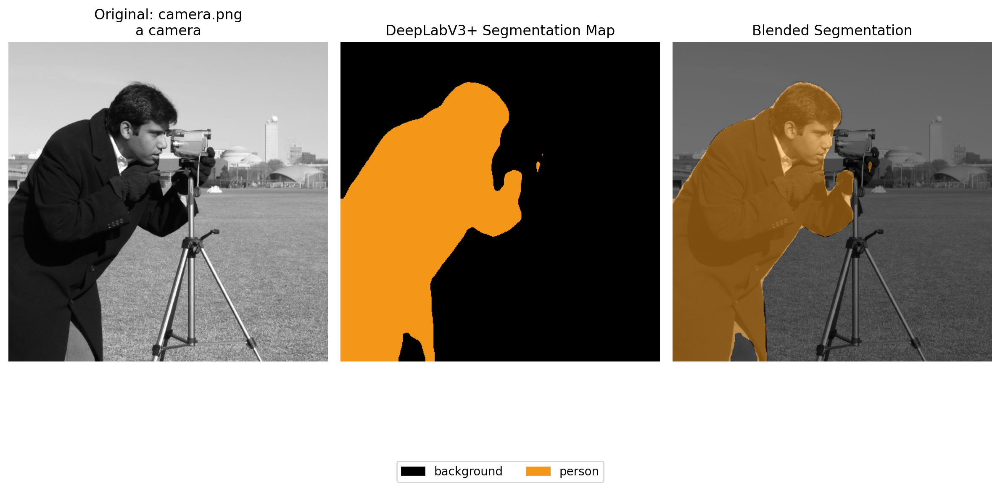

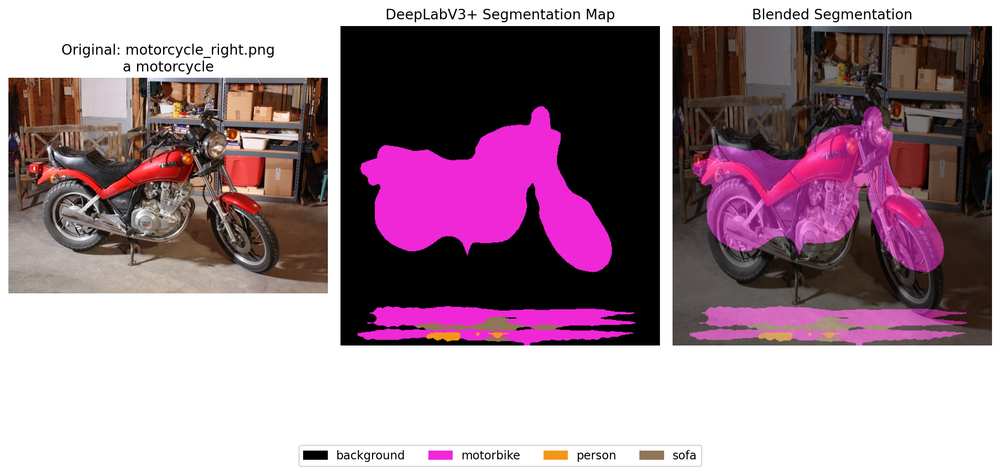

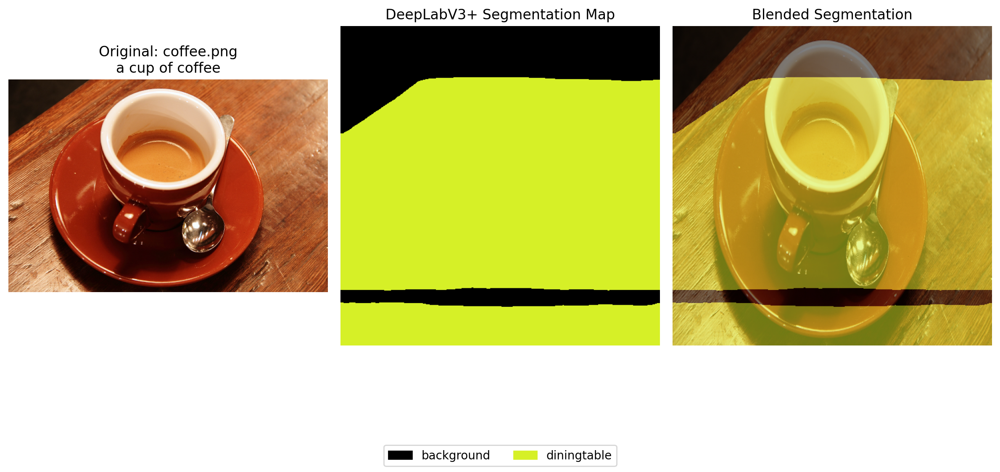

In [ ]:
plt.figure(figsize=(12, 12))
advanced_segmentation_results = []

for i, filename in enumerate([f for f in os.listdir(skimage.data_dir)
                             if f.endswith(".png") or f.endswith(".jpg")]):
    name = os.path.splitext(filename)[0]
    if name not in descriptions:
        continue

    image_path = os.path.join(skimage.data_dir, filename)
    image = Image.open(image_path).convert("RGB")

    predictions, classes, distribution = advanced_segment_and_visualize(
        image, filename, descriptions[name])

    advanced_segmentation_results.append({
        'filename': filename,
        'description': descriptions[name],
        'classes_found': [CLASSES[i] for i in classes],
        'class_distribution': distribution
    })

    plt.plot()

print("\nDeepLabV3+ Segmentation Results Summary:\n")
for result in advanced_segmentation_results:
    print(f"Image: {result['filename']} ({result['description']})")
    print(f"Classes detected: {', '.join(result['classes_found'])}")
    print("Class distribution (% of pixels):")
    for cls, percentage in result['class_distribution'].items():
        print(f"  - {cls}: {percentage:.2f}%")
    print("-" * 50)

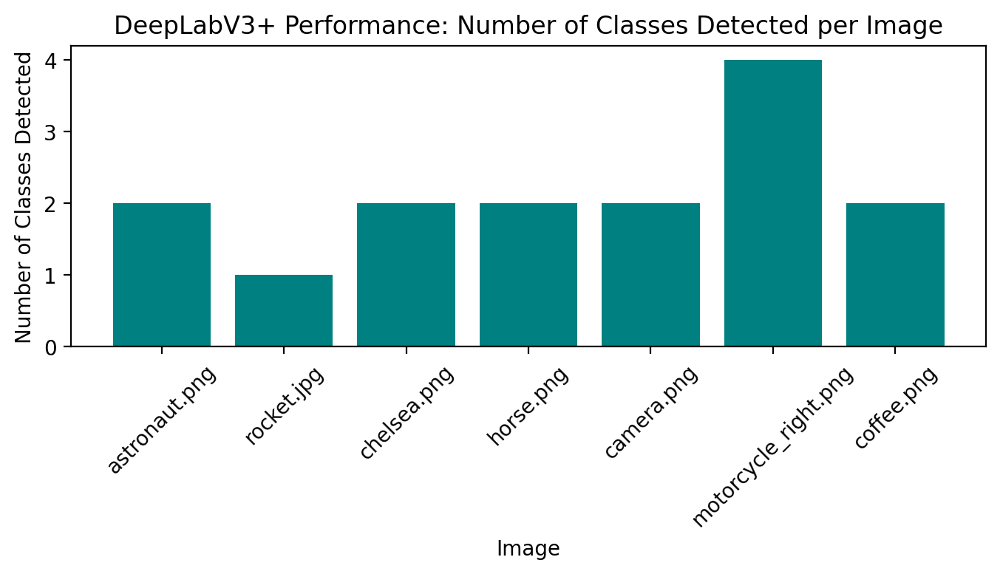

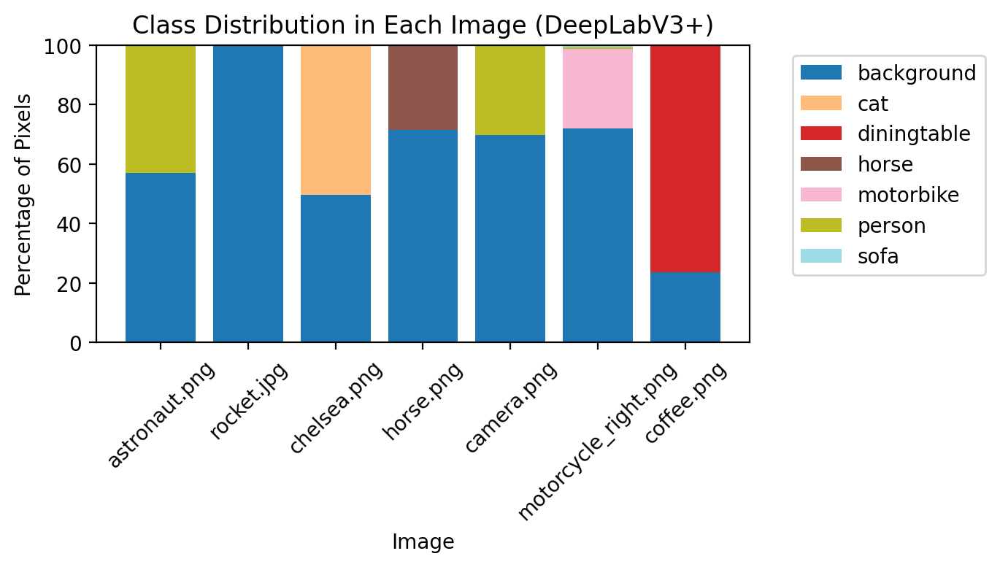

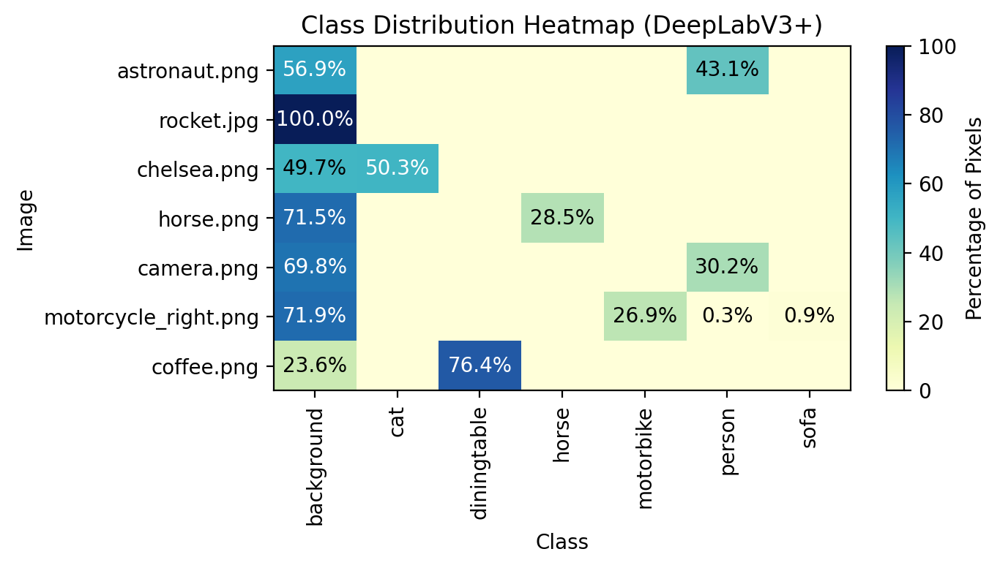

In [ ]:
plt.figure(figsize=(7, 4))
image_names = [result['filename'] for result in advanced_segmentation_results]
class_counts = [len(result['classes_found']) for result in advanced_segmentation_results]

plt.bar(image_names, class_counts, color='teal')
plt.xlabel('Image')
plt.ylabel('Number of Classes Detected')
plt.title('DeepLabV3+ Performance: Number of Classes Detected per Image')
plt.xticks(rotation=45)
plt.tight_layout()

plt.figure(figsize=(7, 4))

all_classes = set()
for result in advanced_segmentation_results:
    all_classes.update(result['class_distribution'].keys())
all_classes = sorted(list(all_classes))

data = np.zeros((len(advanced_segmentation_results), len(all_classes)))
for i, result in enumerate(advanced_segmentation_results):
    for j, cls in enumerate(all_classes):
        if cls in result['class_distribution']:
            data[i, j] = result['class_distribution'][cls]

class_colors = plt.cm.tab20(np.linspace(0, 1, len(all_classes)))

bottom = np.zeros(len(advanced_segmentation_results))
for j, cls in enumerate(all_classes):
    plt.bar(image_names, data[:, j], bottom=bottom, label=cls, color=class_colors[j])
    bottom += data[:, j]

plt.xlabel('Image')
plt.ylabel('Percentage of Pixels')
plt.title('Class Distribution in Each Image (DeepLabV3+)')
plt.xticks(rotation=45)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

plt.figure(figsize=(7, 4))
plt.imshow(data, cmap='YlGnBu', aspect='auto')
plt.colorbar(label='Percentage of Pixels')
plt.xticks(np.arange(len(all_classes)), all_classes, rotation=90)
plt.yticks(np.arange(len(advanced_segmentation_results)), image_names)
plt.xlabel('Class')
plt.ylabel('Image')
plt.title('Class Distribution Heatmap (DeepLabV3+)')

for i in range(len(advanced_segmentation_results)):
    for j in range(len(all_classes)):
        if data[i, j] > 0:
            text_color = 'black' if data[i, j] < 50 else 'white'
            plt.text(j, i, f'{data[i, j]:.1f}%',
                    ha='center', va='center', color=text_color)

plt.tight_layout()

That's the end!

Thank you!